In [12]:
import openeo

connection = openeo.connect("https://openeo.dataspace.copernicus.eu/").authenticate_oidc()

In [20]:
datacube = connection.load_collection(
  "SENTINEL2_L2A",
  spatial_extent={"west": 12.02000046, "south":  50.97999954, "east": 12.91999912, "north": 51.59000015},
  temporal_extent=["2024-02-01", "2024-03-01"],
  bands=["B04"]
)

In [21]:
reduced_datacube = datacube.reduce_dimension(dimension="t", reducer="mean")

In [22]:
exported_path = "data/reduced_b04.tiff"
result = reduced_datacube.save_result(format="GTiff")

In [23]:
job = result.create_job()
job.start_and_wait()
job.get_results().download_files(target=exported_path)

0:00:00 Job 'j-2407018af87842118f4fd82fee6aeaa1': send 'start'
0:00:23 Job 'j-2407018af87842118f4fd82fee6aeaa1': created (progress 0%)
0:00:31 Job 'j-2407018af87842118f4fd82fee6aeaa1': created (progress 0%)
0:00:38 Job 'j-2407018af87842118f4fd82fee6aeaa1': created (progress 0%)
0:00:46 Job 'j-2407018af87842118f4fd82fee6aeaa1': created (progress 0%)
0:00:57 Job 'j-2407018af87842118f4fd82fee6aeaa1': running (progress N/A)
0:01:09 Job 'j-2407018af87842118f4fd82fee6aeaa1': running (progress N/A)
0:01:25 Job 'j-2407018af87842118f4fd82fee6aeaa1': running (progress N/A)
0:01:44 Job 'j-2407018af87842118f4fd82fee6aeaa1': running (progress N/A)
0:02:08 Job 'j-2407018af87842118f4fd82fee6aeaa1': running (progress N/A)
0:02:38 Job 'j-2407018af87842118f4fd82fee6aeaa1': running (progress N/A)
0:03:16 Job 'j-2407018af87842118f4fd82fee6aeaa1': running (progress N/A)
0:04:03 Job 'j-2407018af87842118f4fd82fee6aeaa1': running (progress N/A)
0:05:02 Job 'j-2407018af87842118f4fd82fee6aeaa1': running (progre

[PosixPath('data/reduced_b04.tiff/openEO.tif'),
 PosixPath('data/reduced_b04.tiff/job-results.json')]

In [ ]:
connection.job('j-24070198be5f4ec286b75c7d9e78aa0e').logs()

In [108]:
import rasterio
import numpy as np
from rasterio.plot import show
tiff = rasterio.open("data/satellite/berlin.tiff/openEO.tif")
tensor = tiff.read([1,2,3])
tensor.shape

(3, 6749, 8425)

In [111]:
cleaned_avg = np.mean(tensor[tensor > 0])
tensor[tensor < 0] = cleaned_avg
np.mean(tensor,axis=(1,2))

np.float64(747.5210633298133)

In [116]:
import numpy as np
min_val = np.reshape(np.min(tensor,axis=(1,2) ),(-1,1,1))
max_val = np.reshape(np.max(tensor,axis=(1,2) ),(-1,1,1))
tensor = (tensor - min_val) / (max_val - min_val)
tensor = np.transpose(tensor, (1,2,0))
min_val,max_val

(array([[[62]],
 
        [[88]],
 
        [[56]]], dtype=int16),
 array([[[19768]],
 
        [[18376]],
 
        [[17416]]], dtype=int16))

[34. 43.  1.]


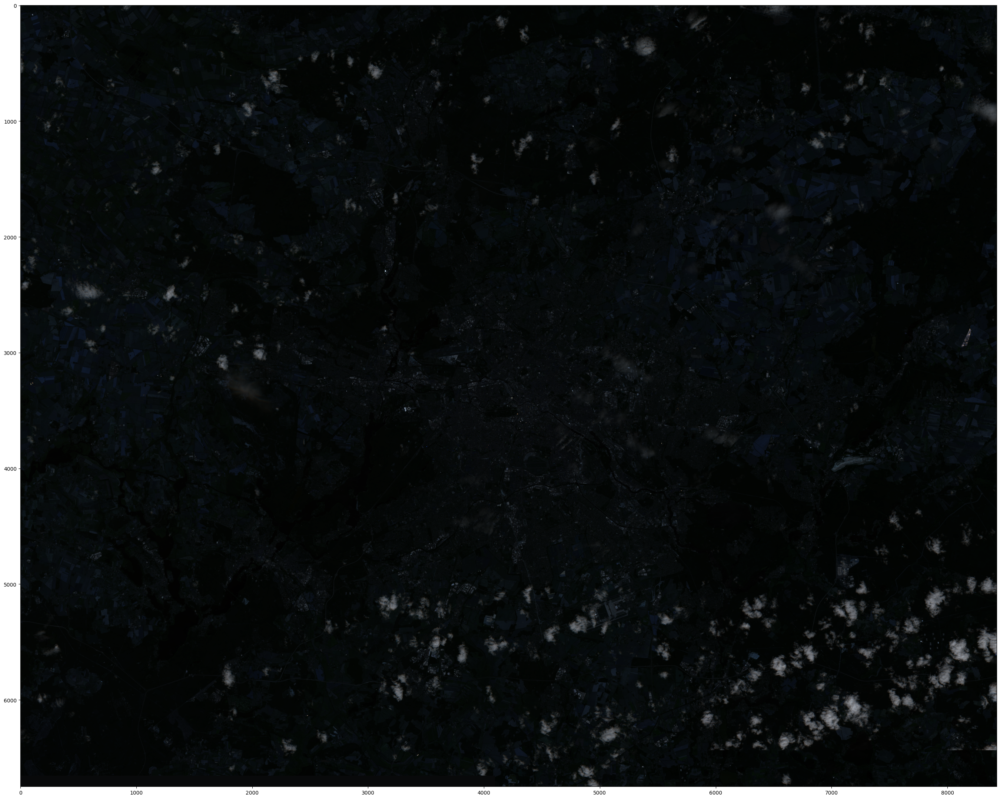

In [118]:
import matplotlib.pyplot as plt

size = np.ceil(np.array(tensor.shape) / 200)
print(size)
plt.figure(figsize=(size[0],size[1]))
plt.imshow(tensor)
plt.savefig("data/satellite/berlin.tiff/berlin.pdf",bbox_inches='tight',dpi=300)

In [157]:
import geopandas as gpd
df = gpd.read_file("data/buildings/Berlin_buildings.gpkg")

In [158]:
df = df.to_crs(tiff.crs)

In [180]:
df.head(10)

,addr:city,addr:country,addr:full,addr:housenumber,addr:housename,addr:postcode,addr:place,addr:street,email,name,...,source,start_date,wikipedia,id,timestamp,version,tags,osm_type,changeset,geometry
0,None,None,None,None,None,None,None,None,None,None,...,None,None,None,4475674,0,0,None,way,NaN,"POLYGON ((384842.549 5820189.654, 384879.558 5..."
1,None,None,None,None,None,None,None,None,None,None,...,Geoportal Berlin / ALKIS,None,None,4675763,0,0,None,way,NaN,"POLYGON ((388260.562 5821632.716, 388268.609 5..."
2,None,None,None,36,None,None,None,Spenerstraße,None,None,...,None,None,None,4675901,0,0,"{""roof:shape"":""flat""}",way,NaN,"POLYGON ((388324.991 5820485.109, 388323.284 5..."
3,None,None,None,None,None,None,None,None,None,None,...,None,None,None,4676147,0,0,"{""roof:levels"":""2"",""roof:shape"":""hipped""}",way,NaN,"POLYGON ((388420.48 5820957.092, 388414.107 58..."
4,None,None,None,None,None,None,None,None,None,Rollsportanlage,...,None,None,None,4676159,0,0,"{""alt_name"":""Inlinehockey Stadion"",""leisure"":""...",way,NaN,"POLYGON ((388765.147 5821421.711, 388747.189 5..."
5,Berlin,DE,None,2-4,None,10551,None,Arminiusstraße,None,Arminiusmarkthalle,...,None,1891,de:Moabiter Markthalle,4703544,0,0,"{""addr:suburb"":""Moabit"",""architect"":""Hermann B...",way,NaN,"POLYGON ((387325.398 5820999.575, 387322.299 5..."
6,Berlin,DE,None,11,None,14055,None,Messedamm,None,Internationales Congress Centrum Berlin,...,None,None,de:Internationales Congress Centrum Berlin,4706588,0,0,"{""addr:suburb"":""Westend"",""layer"":""1"",""roof:sha...",way,NaN,"POLYGON ((383291.788 5818438.753, 383289.614 5..."
7,None,None,None,None,None,None,None,None,None,Halle 8,...,None,None,None,4706590,0,0,"{""roof:shape"":""flat""}",way,NaN,"POLYGON ((382906.913 5818360.485, 382883.4 581..."
8,None,None,None,None,None,None,None,None,None,Halle 10,...,None,None,None,4706591,0,0,"{""roof:shape"":""flat""}",way,NaN,"POLYGON ((382983.877 5818453.737, 382981.124 5..."
9,Berlin,DE,None,17,None,13353,None,Triftstraße,None,Parkhaus Charité,...,None,None,None,4751061,0,0,"{""access"":""yes"",""addr:suburb"":""Wedding"",""build...",way,NaN,"POLYGON ((388333.976 5822688.884, 388389.896 5..."


In [160]:
minx, miny, maxx, maxy = df.total_bounds
left, bottom, right, top = tiff.bounds

In [176]:
top - bottom

67490.0

In [167]:
df_test = df.head(10)

In [179]:
def test(poly):
    x,y = poly.exterior.xy
    print(len(x))
    print(y.astype(np.int32))
    

polys = df_test["geometry"].to_list()
test(polys[0])

5


AttributeError: 'array.array' object has no attribute 'astype'

In [183]:
from rasterio.features import rasterize
test_tensor = rasterize(polys, out_shape=tiff.shape, transform=tiff.transform)

In [185]:
building_tensor = rasterize(df["geometry"], out_shape=tiff.shape, transform=tiff.transform)


In [191]:
np.unique(building_tensor)

array([0, 1])

In [192]:
overlay = tensor.copy()
overlay[building_tensor==1] = [1, 0, 0]

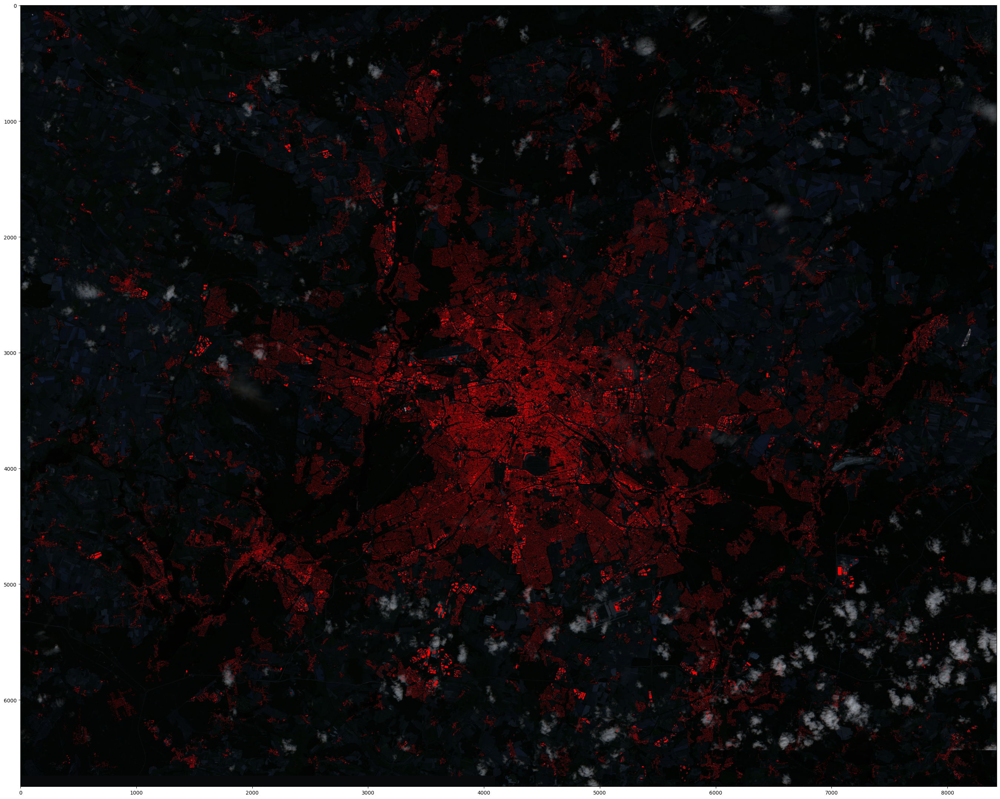

In [194]:
plt.figure(figsize=(size[0],size[1]))
plt.imshow(overlay)
plt.savefig("data/satellite/berlin.tiff/berlin3.pdf",bbox_inches='tight',dpi=300)

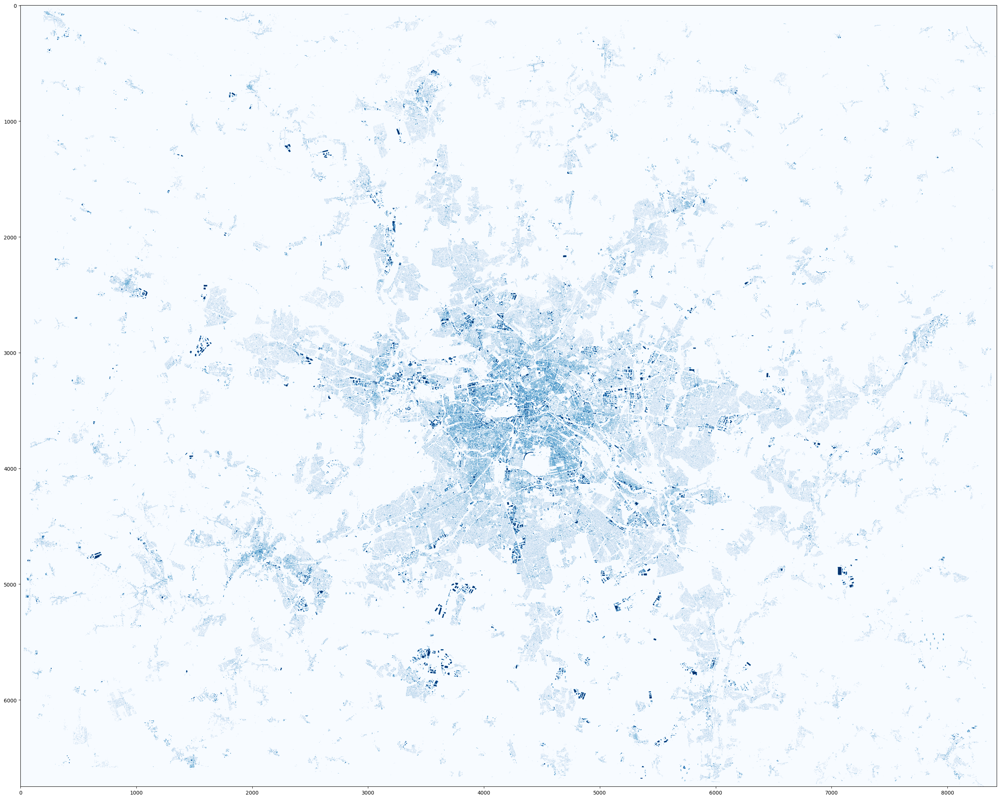

In [189]:
plt.figure(figsize=(size[0],size[1]))
plt.imshow(building_tensor,cmap="Blues")

In [164]:
delta_x = maxx - minx
delta_y = maxy - miny
delta_x, delta_y

(np.float64(83840.90109275619), np.float64(67213.96707911883))

In [152]:
delta_x, delta_y

(np.float64(1.2199974060058594), np.float64(0.5900001525878906))

In [148]:
tensor.shape

(6749, 8425, 3)

In [149]:
tiff.crs

CRS.from_epsg(32633)

In [129]:
df.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [130]:
df2 = df.to_crs(tiff.crs)

In [131]:
df2.crs

<Projected CRS: EPSG:32633>
Name: WGS 84 / UTM zone 33N
Axis Info [cartesian]:
- [east]: Easting (metre)
- [north]: Northing (metre)
Area of Use:
- undefined
Coordinate Operation:
- name: UTM zone 33N
- method: Transverse Mercator
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [139]:
df2_head = df2.head(5)

In [145]:
df2_head['pixel_geometry'] = df2_head['geometry'].apply(lambda geom: transform_geometry(geom, transform))

ValueError: too many values to unpack (expected 6)

In [155]:
df2_head.head(5)

,addr:city,addr:country,addr:full,addr:housenumber,addr:housename,addr:postcode,addr:place,addr:street,email,name,...,source,start_date,wikipedia,id,timestamp,version,tags,osm_type,changeset,geometry
0,None,None,None,None,None,None,None,None,None,None,...,None,None,None,4475674,0,0,None,way,NaN,"POLYGON ((384842.549 5820189.654, 384879.558 5..."
1,None,None,None,None,None,None,None,None,None,None,...,Geoportal Berlin / ALKIS,None,None,4675763,0,0,None,way,NaN,"POLYGON ((388260.562 5821632.716, 388268.609 5..."
2,None,None,None,36,None,None,None,Spenerstraße,None,None,...,None,None,None,4675901,0,0,"{""roof:shape"":""flat""}",way,NaN,"POLYGON ((388324.991 5820485.109, 388323.284 5..."
3,None,None,None,None,None,None,None,None,None,None,...,None,None,None,4676147,0,0,"{""roof:levels"":""2"",""roof:shape"":""hipped""}",way,NaN,"POLYGON ((388420.48 5820957.092, 388414.107 58..."
4,None,None,None,None,None,None,None,None,None,Rollsportanlage,...,None,None,None,4676159,0,0,"{""alt_name"":""Inlinehockey Stadion"",""leisure"":""...",way,NaN,"POLYGON ((388765.147 5821421.711, 388747.189 5..."
